<center><h1>Predictive Modelling of Eating-Out problem</h1></center>

### <font >Table of contents<font><a class='anchor' id='top'></a>
1. [Introduction](#introduction)
2. [Understanding Data](#data)
3. [Univariate Analysis](#univariate)
4. [Bivariate Analysis](#bivariate)
5. [Multivariate Analysis](#multivariate)
6. [Cuisine Density Map](#cuisinedensity)
7. [Feature Engineering](#featureeng)
8. [Linear Regression](#linearreg)
9. [Logistic Regression](#logisticreg)

# 1. Introduction <a class='anchor' id='introduction'></a> [↑](#top)

This project is accompanied with a real-world dataset containing more than 10K records 
for restaurants existing in the Sydney area in the year 2018. 

For every single record, information about the restaurant goes from basic details such as name, address, and location to advanced details such as rating. 

In this notebook we will be using data science skills to predict the restaurant’s success using different machine learning algorithms. 

### Column details

![Alt text](image-2.png)

We will be answering some questions using EDA - 
* How many unique cuisines are served by Sydney restaurants?
* Which suburbs (top-3) have the highest number of restaurants?
* Restaurants with ‘excellent’ rating are mostly very expensive while those with ‘Poor’ rating are rarely expensive?
* Which business types is most common in sydney?


We will be building a linear regression model to predict the restaurants rating from other features (columns) in the dataset.

And a logistic regression model by simplifing the problem into binary classifications where class 1 contains ‘Poor’ and ‘Average’ records while class 2 contains ‘Good’, ‘Very Good’ and ‘Excellent’ records.


# 2. Understanding data <a class='anchor' id='data'></a> [↑](#top)

In [58]:
## Loading librarys
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib_inline
from scipy import stats
import warnings

warnings.filterwarnings("ignore", "is_categorical_dtype")
warnings.filterwarnings("ignore", "use_inf_as_na")
warnings.filterwarnings("ignore")

# matplotlib_inline.backend_inline.set_matplotlib_formats('svg')
# sns.set_style("whitegrid")
sns.set_theme()

In [59]:
data = pd.read_csv("data/zomato_df_final_data.csv")

In [60]:
data.columns

Index(['address', 'cost', 'cuisine', 'lat', 'link', 'lng', 'phone',
       'rating_number', 'rating_text', 'subzone', 'title', 'type', 'votes',
       'groupon', 'color', 'cost_2', 'cuisine_color'],
      dtype='object')

In [61]:
data.head(5)

,address,cost,cuisine,lat,link,lng,phone,rating_number,rating_text,subzone,title,type,votes,groupon,color,cost_2,cuisine_color
0,"371A Pitt Street, CBD, Sydney",50.0,"['Hot Pot', 'Korean BBQ', 'BBQ', 'Korean']",-33.876059,https://www.zomato.com/sydney/sydney-madang-cbd,151.207605,02 8318 0406,4.0,Very Good,CBD,Sydney Madang,['Casual Dining'],1311.0,False,#e15307,5.243902,#6f706b
1,"Shop 7A, 2 Huntley Street, Alexandria, Sydney",80.0,"['Cafe', 'Coffee and Tea', 'Salad', 'Poké']",-33.910999,https://www.zomato.com/sydney/the-grounds-of-a...,151.193793,02 9699 2225,4.6,Excellent,"The Grounds of Alexandria, Alexandria",The Grounds of Alexandria Cafe,['Café'],3236.0,False,#9c3203,7.560976,#6f706b
2,"Level G, The Darling at the Star, 80 Pyrmont ...",120.0,['Japanese'],-33.867971,https://www.zomato.com/sydney/sokyo-pyrmont,151.195210,1800 700 700,4.9,Excellent,"The Star, Pyrmont",Sokyo,['Fine Dining'],1227.0,False,#7f2704,10.650407,#6f706b
3,"Sydney Opera House, Bennelong Point, Circular...",270.0,['Modern Australian'],-33.856784,https://www.zomato.com/sydney/bennelong-restau...,151.215297,02 9240 8000,4.9,Excellent,Circular Quay,Bennelong Restaurant,"['Fine Dining', 'Bar']",278.0,False,#7f2704,22.235772,#4186f4
4,"20 Campbell Street, Chinatown, Sydney",55.0,"['Thai', 'Salad']",-33.879035,https://www.zomato.com/sydney/chat-thai-chinatown,151.206409,02 8317 4811,4.5,Excellent,Chinatown,Chat Thai,['Casual Dining'],2150.0,False,#a83703,5.630081,#6f706b


In [62]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10500 entries, 0 to 10499
Data columns (total 17 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   address        10500 non-null  object 
 1   cost           10154 non-null  float64
 2   cuisine        10500 non-null  object 
 3   lat            10308 non-null  float64
 4   link           10500 non-null  object 
 5   lng            10308 non-null  float64
 6   phone          10500 non-null  object 
 7   rating_number  7184 non-null   float64
 8   rating_text    7184 non-null   object 
 9   subzone        10500 non-null  object 
 10  title          10500 non-null  object 
 11  type           10452 non-null  object 
 12  votes          7184 non-null   float64
 13  groupon        10500 non-null  bool   
 14  color          10500 non-null  object 
 15  cost_2         10154 non-null  float64
 16  cuisine_color  10500 non-null  object 
dtypes: bool(1), float64(6), object(10)
memory usage: 1

* There are many columns with null values

In [63]:
# checking null values % in every column of our data
(data.isnull().sum()/len(data)*100).round(2).sort_values(ascending=False)

rating_text      31.58
rating_number    31.58
votes            31.58
cost_2            3.30
cost              3.30
lat               1.83
lng               1.83
type              0.46
color             0.00
groupon           0.00
address           0.00
title             0.00
subzone           0.00
phone             0.00
link              0.00
cuisine           0.00
cuisine_color     0.00
dtype: float64

* There are more than 30 % restaurents where rating_number, rating_text and votes is not available in data.
* Columns cost, cost_2, lat, lng and type also have missing values.

In [64]:
data.nunique(dropna=True)

address           9821
cost                83
cuisine           1759
lat               8030
link             10499
lng               7992
phone             9638
rating_number       32
rating_text          5
subzone            572
title            10407
type                66
votes              547
groupon              2
color               33
cost_2              83
cuisine_color        5
dtype: int64

In [65]:
## Converting columns to appropriate data type
df = data.astype({'rating_number':'category', 'rating_text':'category', 'groupon':'category'})

In [66]:
df.describe()

,cost,lat,lng,votes,cost_2
count,10154.000000,10308.000000,10308.000000,7184.000000,10154.000000
mean,51.153240,-32.921377,148.067359,83.581013,5.332974
std,27.799485,8.263449,26.695402,175.117966,2.147115
min,8.000000,-37.858473,-123.270371,4.000000,2.000000
25%,30.000000,-33.899094,151.061061,12.000000,3.699187
50%,45.000000,-33.872741,151.172468,32.000000,4.857724
75%,60.000000,-33.813451,151.208940,87.000000,6.016260
max,500.000000,51.500986,152.869052,3236.000000,40.000000


In [67]:
df.describe(include=["O", "category"])

,address,cuisine,link,phone,rating_number,rating_text,subzone,title,type,groupon,color,cuisine_color
count,10500,10500,10500,10500,7184.0,7184,10500,10500,10452,10500,10500,10500
unique,9821,1759,10499,9638,32.0,5,572,10407,66,2,33,5
top,"Level 5, Westfield Pitt Street Mall, 188 Pitt...",['Cafe'],https://www.zomato.com/sydney/royal-stacks-cha...,Not available for this place,3.2,Average,CBD,Royal Hotel,['Casual Dining'],False,#000000,#6f706b
freq,10,1745,2,636,673.0,4501,476,5,4854,10378,3316,8147


* Many restaurents have same address and some have same tiltle also.
* Many restaurents have same cost as unique values in cost is 84 only.

In [68]:
## Dropping columns which are not useful right now for data visualization 
## as some have all unique values in column and some are not useful for modeling.

df = df.drop(['color', 'cost_2', 'cuisine_color', 'lng', 'lat', 'link'], axis=1)

In [69]:
## Droping duplicate rows
df = df.drop_duplicates()
df.shape

(10499, 11)

In [70]:
df.columns

Index(['address', 'cost', 'cuisine', 'phone', 'rating_number', 'rating_text',
       'subzone', 'title', 'type', 'votes', 'groupon'],
      dtype='object')

In [71]:
def convert_to_list(df):
    try:
        return (df
                .replace('[', '')
                .replace(']', '')
                .replace('\'', '')
                .split(', ')
            )
    except:
        return df

In [72]:
data.columns

Index(['address', 'cost', 'cuisine', 'lat', 'link', 'lng', 'phone',
       'rating_number', 'rating_text', 'subzone', 'title', 'type', 'votes',
       'groupon', 'color', 'cost_2', 'cuisine_color'],
      dtype='object')

In [73]:
## Converting cuisine and type column data to list
df_exploded = (data
        .assign(cuisine=data.cuisine.apply(convert_to_list))
        .assign(type=data.type.apply(convert_to_list))
    )

In [74]:
df_exploded.head()

,address,cost,cuisine,lat,link,lng,phone,rating_number,rating_text,subzone,title,type,votes,groupon,color,cost_2,cuisine_color
0,"371A Pitt Street, CBD, Sydney",50.0,"[Hot Pot, Korean BBQ, BBQ, Korean]",-33.876059,https://www.zomato.com/sydney/sydney-madang-cbd,151.207605,02 8318 0406,4.0,Very Good,CBD,Sydney Madang,[Casual Dining],1311.0,False,#e15307,5.243902,#6f706b
1,"Shop 7A, 2 Huntley Street, Alexandria, Sydney",80.0,"[Cafe, Coffee and Tea, Salad, Poké]",-33.910999,https://www.zomato.com/sydney/the-grounds-of-a...,151.193793,02 9699 2225,4.6,Excellent,"The Grounds of Alexandria, Alexandria",The Grounds of Alexandria Cafe,[Café],3236.0,False,#9c3203,7.560976,#6f706b
2,"Level G, The Darling at the Star, 80 Pyrmont ...",120.0,[Japanese],-33.867971,https://www.zomato.com/sydney/sokyo-pyrmont,151.195210,1800 700 700,4.9,Excellent,"The Star, Pyrmont",Sokyo,[Fine Dining],1227.0,False,#7f2704,10.650407,#6f706b
3,"Sydney Opera House, Bennelong Point, Circular...",270.0,[Modern Australian],-33.856784,https://www.zomato.com/sydney/bennelong-restau...,151.215297,02 9240 8000,4.9,Excellent,Circular Quay,Bennelong Restaurant,"[Fine Dining, Bar]",278.0,False,#7f2704,22.235772,#4186f4
4,"20 Campbell Street, Chinatown, Sydney",55.0,"[Thai, Salad]",-33.879035,https://www.zomato.com/sydney/chat-thai-chinatown,151.206409,02 8317 4811,4.5,Excellent,Chinatown,Chat Thai,[Casual Dining],2150.0,False,#a83703,5.630081,#6f706b


In [75]:
df_exploded = df_exploded.explode(['type'])
df_exploded = df_exploded.explode(['cuisine'])
df_exploded = df_exploded.drop_duplicates()

In [76]:
df_exploded.nunique()

address           9821
cost                83
cuisine            134
lat               8030
link             10499
lng               7992
phone             9638
rating_number       32
rating_text          5
subzone            572
title            10407
type                14
votes              547
groupon              2
color               33
cost_2              83
cuisine_color        5
dtype: int64

* There are 134 unique cuisines servered in sydeny restaurants.
* There are 14 unique restaurant business type are there in sydney.

# 3. Univariate Analysis <a class='anchor' id='univariate'></a> [↑](#top)

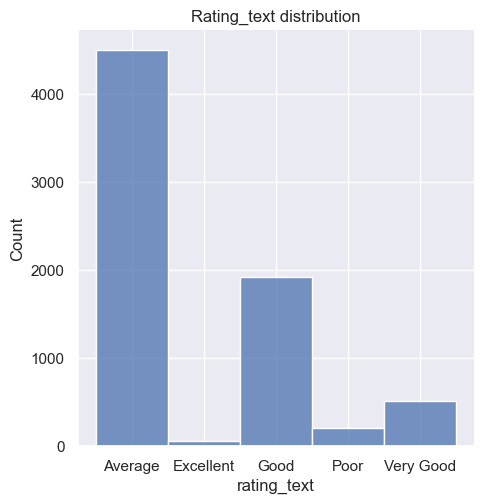

In [77]:
sns.displot(df, x='rating_text')
plt.title('Rating_text distribution')
plt.show()

* Large number of restaurants are having good or average rating text.

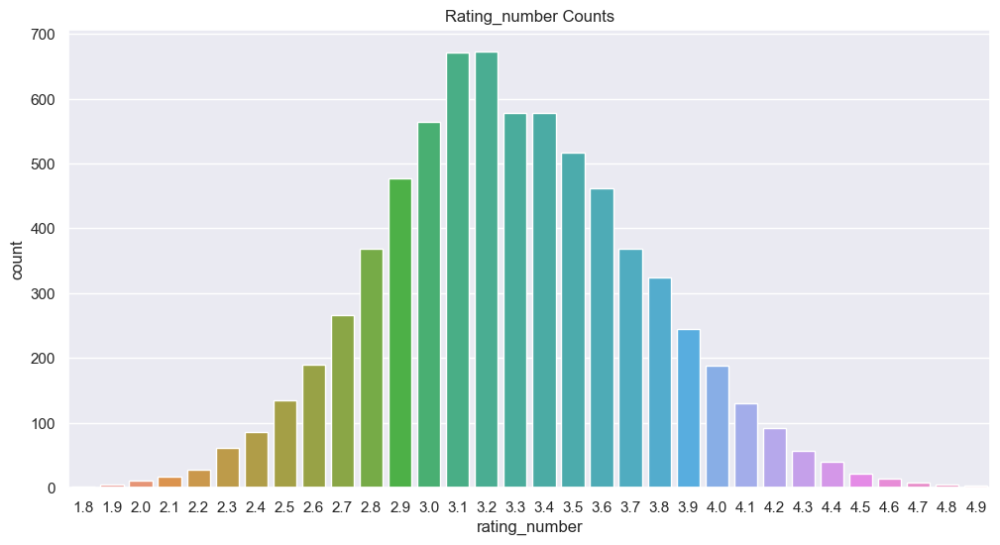

In [78]:
plt.figure(figsize=(12,6))
sns.countplot(df, x='rating_number')
plt.title('Rating_number Counts')
plt.show()

* Rating number are looking almost normally distributed with mean around 3.2

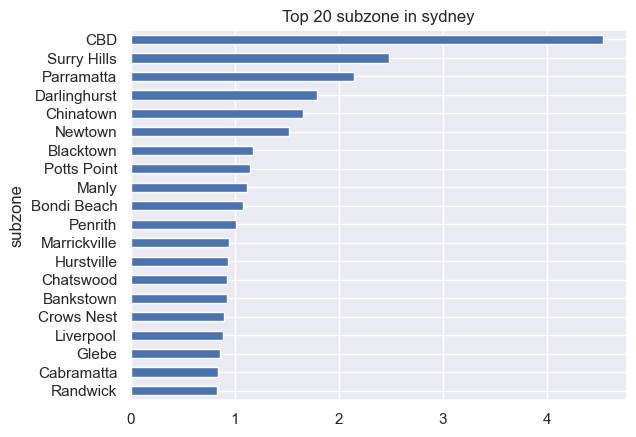

In [79]:
## Plotting top 20 subzones with % of total so it will be clear to understand.
## We will be doing same for columns which have large number of unique values.
(
    (df
    ['subzone']
    .value_counts(ascending=False, normalize=True) * 100)
    .head(20)
    .plot(kind='barh')
    .invert_yaxis()
)
plt.title('Top 20 subzone in sydney')
plt.show()

* Top three subzones are CBD, Surry Hills and Parramatta. They have around 9% of restaurants of sydney.

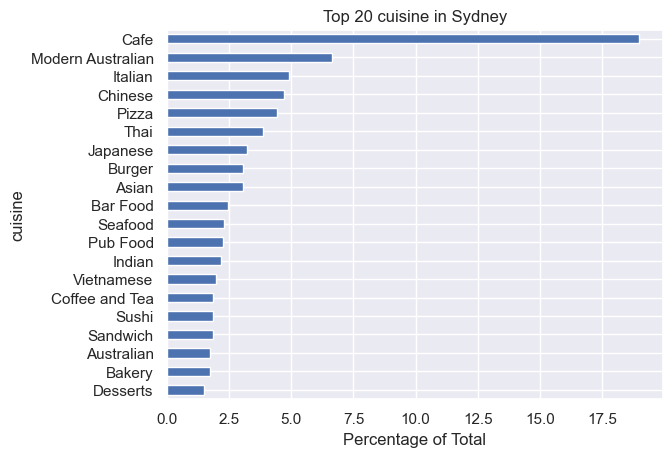

In [80]:
(
    (df_exploded
    ['cuisine']
    .value_counts( ascending=False, normalize=True) * 100
    )
    .head(20)
    .round(2)
    .plot(kind='barh')
    .invert_yaxis()
)
plt.title('Top 20 cuisine in Sydney')
plt.xlabel('Percentage of Total')
plt.show()

* Top 5 cuisines are Cafe, Modern Australian, Chinese, Italian and Pizza. 
* Almost 19% of restaurants are having Cafe cuisine.

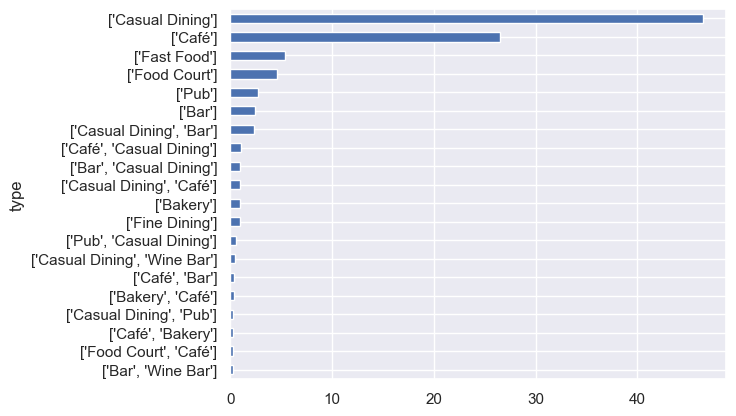

In [81]:
(
    (df
        ['type']
        .value_counts(normalize=True, ascending=False)*100
        )
    .round(2)
    .head(20)
    .plot.barh()
    .invert_yaxis()
)


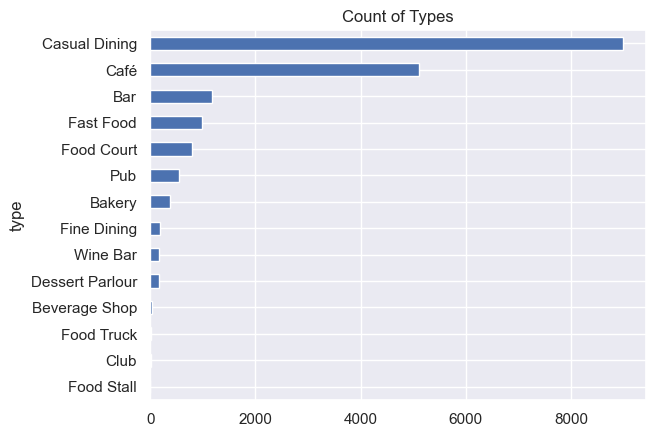

In [82]:
(df_exploded
    ['type']
    .value_counts(ascending=False)
    .round(2)
    .plot(kind='barh')
    .invert_yaxis()
)
plt.title('Count of Types')
plt.show()

* Top 3 business type of restaurants in sydney are Casual Dining, Cafe and Bar.

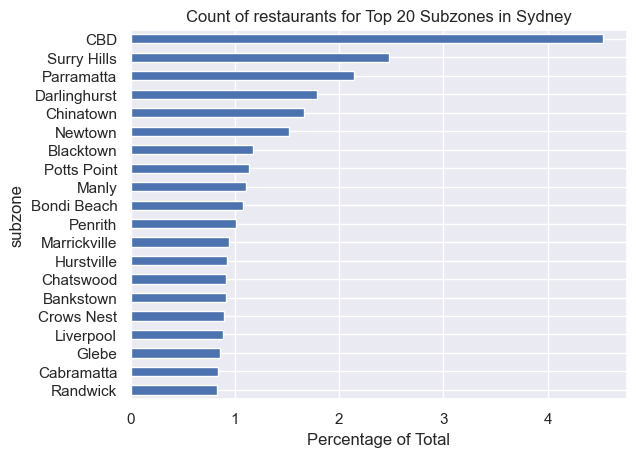

In [83]:
((df
    ['subzone']
    .value_counts(ascending=False, normalize=True) * 100)
    .round(2)
    .head(20)
    .plot(kind='barh')
    .invert_yaxis()
)
plt.title('Count of restaurants for Top 20 Subzones in Sydney')
plt.xlabel('Percentage of Total')
plt.show()

* Top 3 subzones which have highest number of restaurants are CBD, Surry Hills and Parramatta.

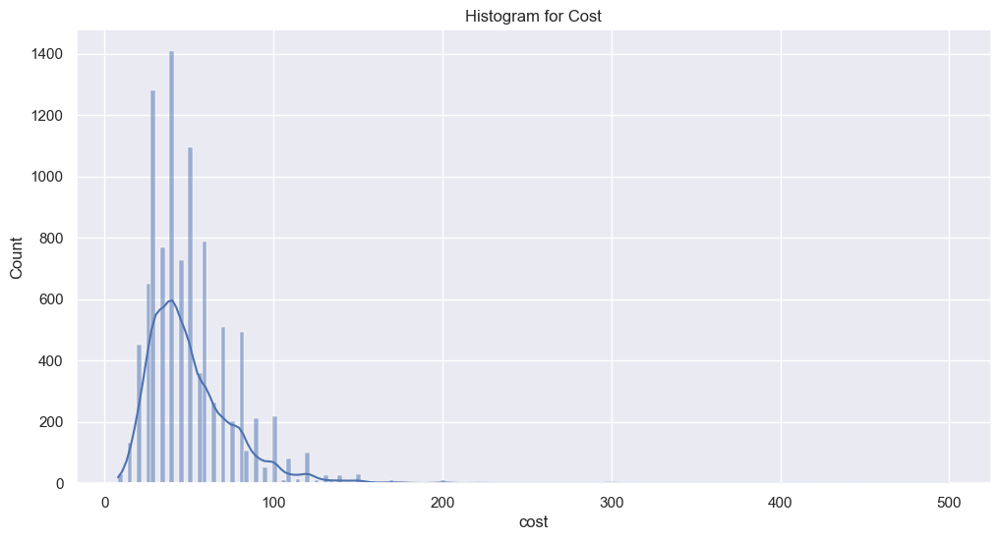

In [84]:
plt.figure(figsize=(12,6))
sns.histplot(df, x='cost', kde=True)
plt.title('Histogram for Cost')
plt.show()

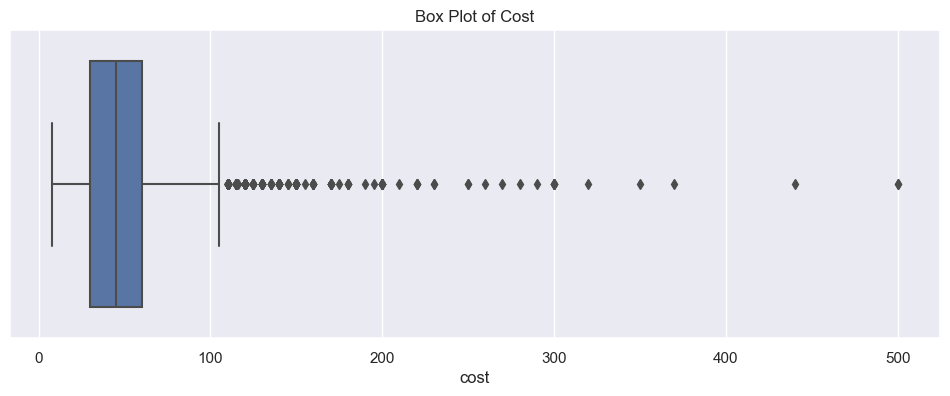

In [85]:
plt.figure(figsize=(12,4))
sns.boxplot(df, x='cost')
plt.title('Box Plot of Cost')
plt.show()

* There are many outliers there in cost column.

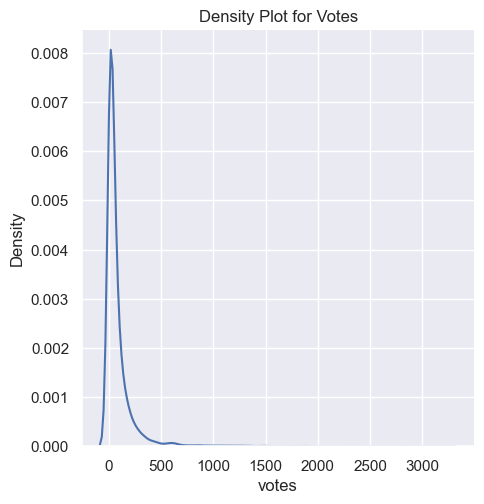

In [86]:
sns.displot(df, x='votes', kind='kde')
plt.title('Density Plot for Votes')
plt.show()

Text(0.5, 1.0, 'Box Plot for Votes')

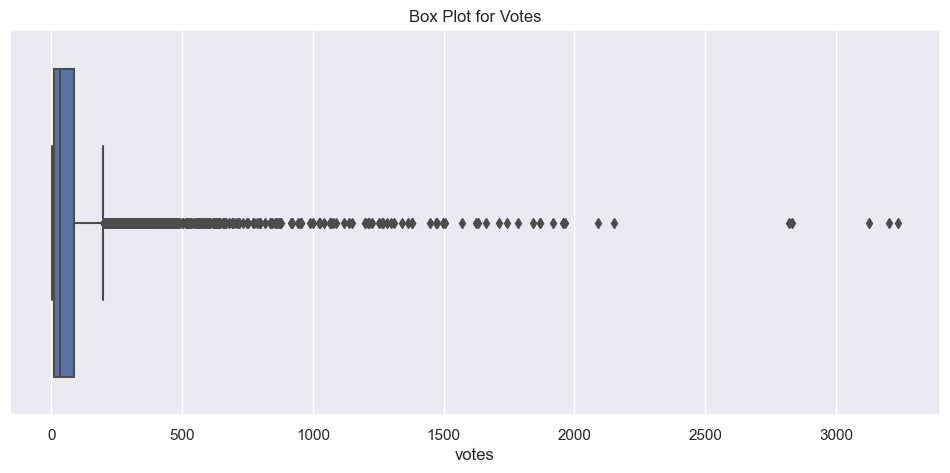

In [87]:
plt.figure(figsize=(12,5))
sns.boxplot(df, x='votes')
plt.title('Box Plot for Votes')

* Too many outliers are there in votes column.

Text(0.5, 1.0, 'Groupon Counts')

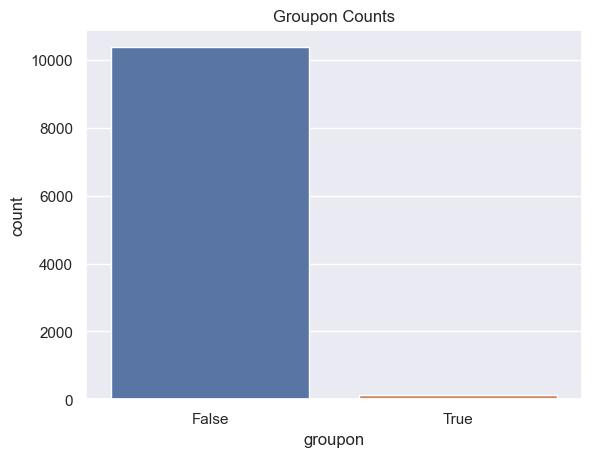

In [88]:
sns.countplot(df, x='groupon')
plt.title('Groupon Counts')

* Groupon has mostly False value means very few restaurants are promoting itself on Groupon.com.

In [89]:
df.groupby('rating_text').cost.describe()

,count,mean,std,min,25%,50%,75%,max
rating_text,,,,,,,,
Average,4420.0,51.021267,22.831674,10.0,35.0,45.0,60.0,200.0
Excellent,51.0,101.666667,113.215134,20.0,40.0,60.0,120.0,500.0
Good,1902.0,59.535752,29.539042,10.0,40.0,50.0,70.0,370.0
Poor,201.0,55.845771,23.738810,20.0,40.0,50.0,70.0,180.0
Very Good,506.0,71.515810,44.030286,15.0,45.0,60.0,80.0,300.0


# 4. Bivariate Analysis <a class='anchor' id='bivariate'></a> [↑](#top)

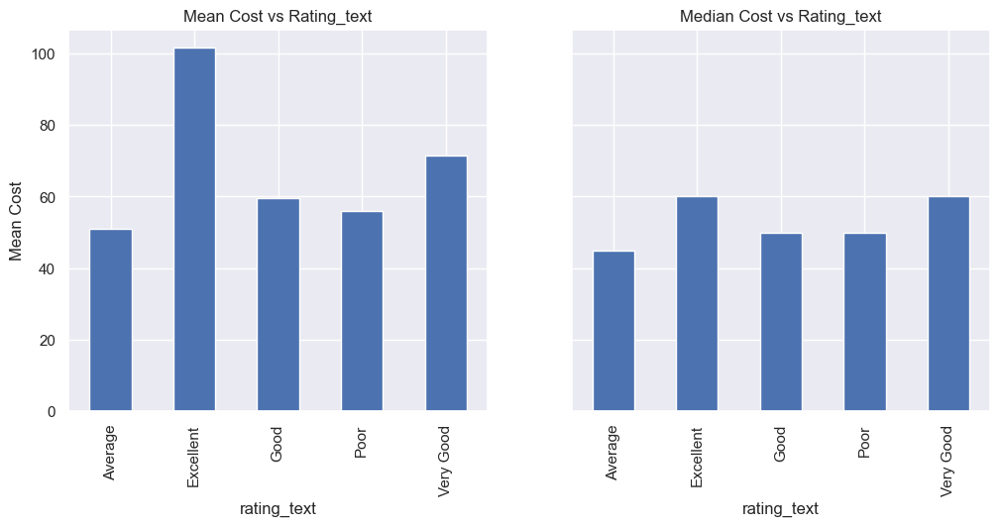

In [90]:
f, ax = plt.subplots(1,2, figsize=(12,5), sharey=True)
df.groupby(['rating_text']).cost.mean().plot(kind='bar', ax=ax[0])
ax[0].set_title('Mean Cost vs Rating_text')
ax[0].set_ylabel('Mean Cost')

df.groupby(['rating_text']).cost.median().plot(kind='bar', ax=ax[1])
ax[1].set_title('Median Cost vs Rating_text')
ax[1].set_ylabel('Median Cost')
plt.show()

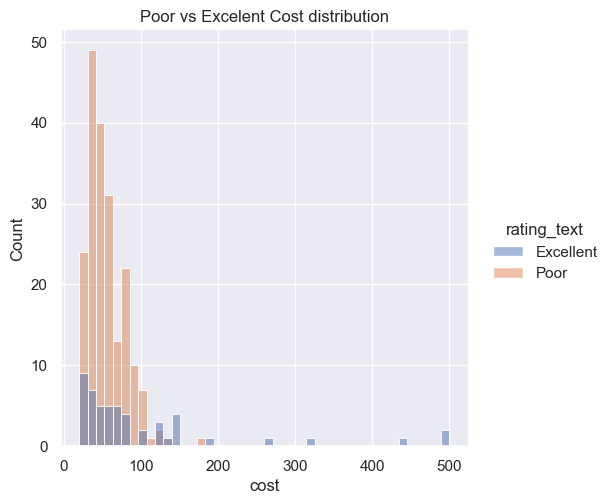

In [91]:
sns.displot(
    data[(data.rating_text == 'Poor') | (data.rating_text == 'Excellent')]
    , hue='rating_text'
    , x='cost'
    , kind='hist'
    )
plt.title('Poor vs Excelent Cost distribution')
plt.show()

* Restaurant with Excellent rating is mostly expensive while Poor rating restaurants are cheaper.

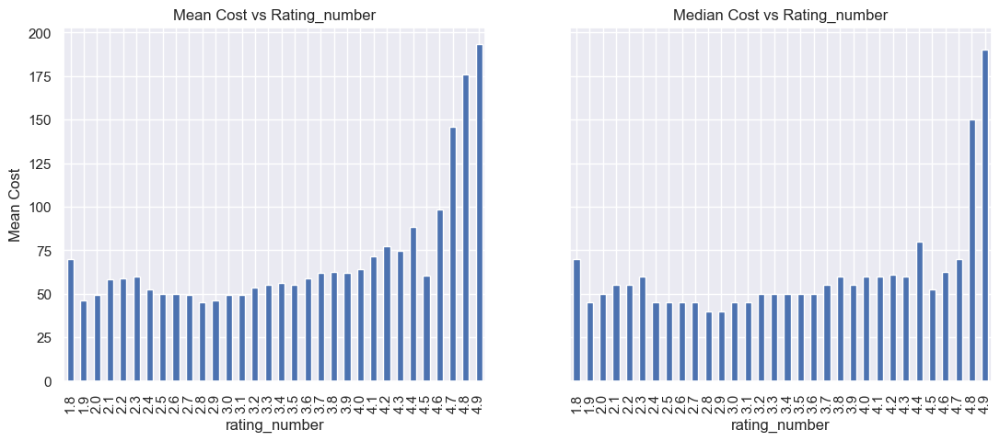

In [92]:
f, ax = plt.subplots(1,2, figsize=(13,5), sharey=True)
df.groupby(['rating_number'], observed=False).cost.mean().plot(kind='bar', ax=ax[0])
ax[0].set_title('Mean Cost vs Rating_number')
ax[0].set_ylabel('Mean Cost')

df.groupby(['rating_number'], observed=False).cost.median().plot(kind='bar', ax=ax[1])
ax[1].set_title('Median Cost vs Rating_number')
plt.show()

* We can see mean and median cost is higher for higher rating_number.

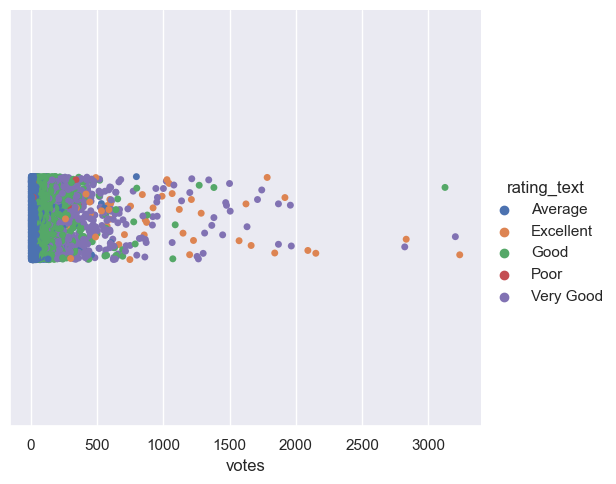

In [93]:
sns.catplot(df, x='votes', hue='rating_text')

* Average rated restaurants have less votes.
* Good rated restaurants have higher votes than average rated.

<Axes: xlabel='rating_number', ylabel='votes'>

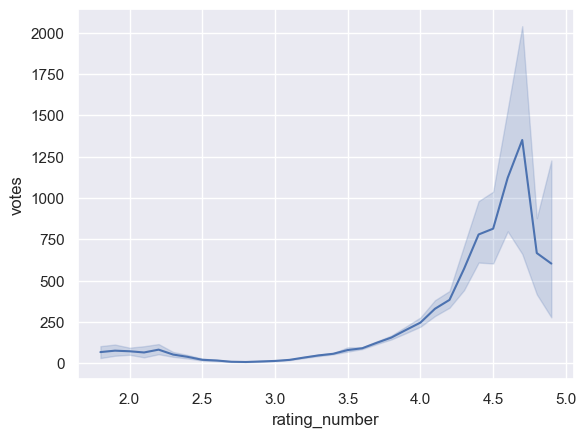

In [94]:
sns.lineplot(df, x='rating_number', y='votes')

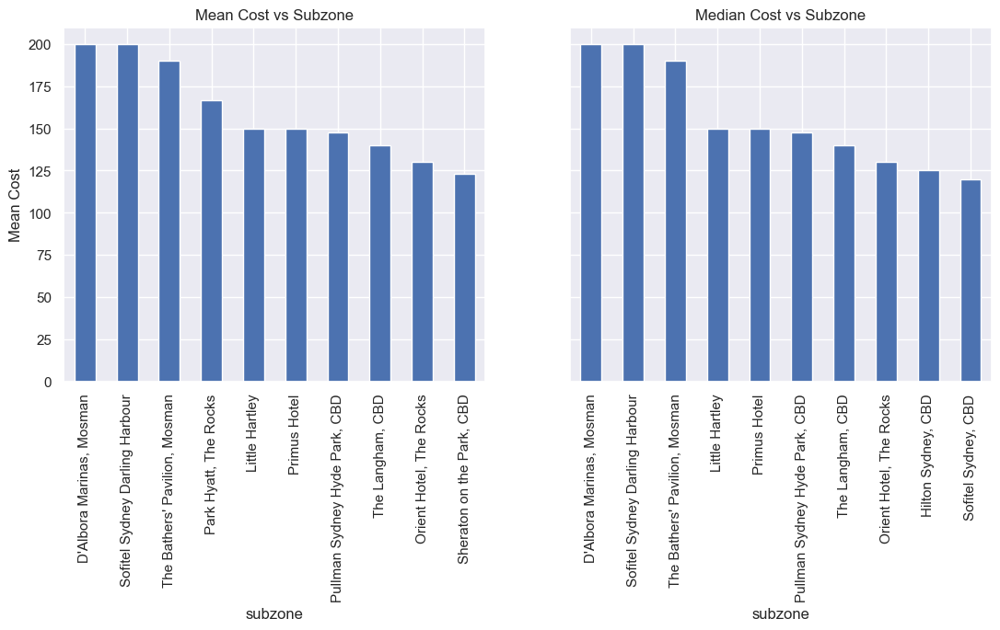

In [95]:
f, ax = plt.subplots(1,2, figsize=(13,5), sharey=True)
df.groupby(['subzone'], observed=False).cost.mean().sort_values(ascending=False).head(10).plot(kind='bar', ax=ax[0])
ax[0].set_title('Mean Cost vs Subzone')
ax[0].set_ylabel('Mean Cost')

df.groupby(['subzone'], observed=False).cost.median().sort_values(ascending=False).head(10).plot(kind='bar', ax=ax[1])
ax[1].set_title('Median Cost vs Subzone')
plt.show()

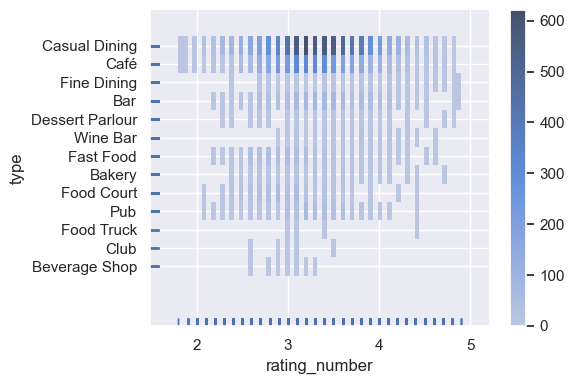

In [96]:
sns.displot(df_exploded.dropna(), x='rating_number', y='type', rug=True, aspect=1.5, cbar=True, height=4)

* Casual Dining and Cafe restaurant business type mostly got rating around 3 and 4.

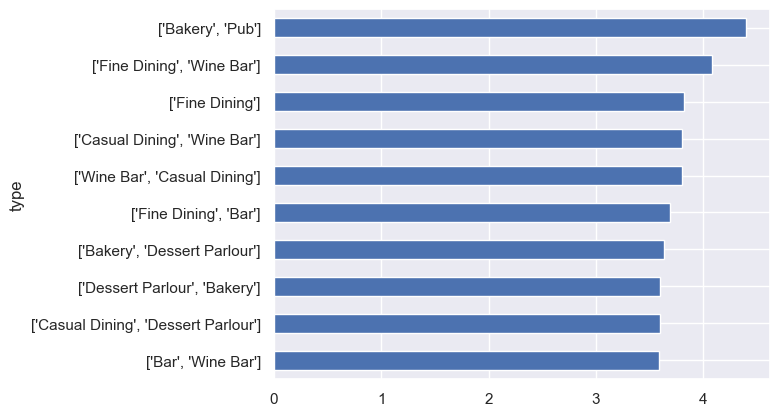

In [97]:
(
    data
        .groupby('type')
        .rating_number
        .mean()
        .sort_values(ascending=False)
        .head(10)
        .plot(kind='barh')
        .invert_yaxis()
)

* Business type (Bakery, Pub), (Fine Dining, Wine Bar) and Fine Dining has highest mean rating_number.

<Axes: xlabel='cost', ylabel='votes'>

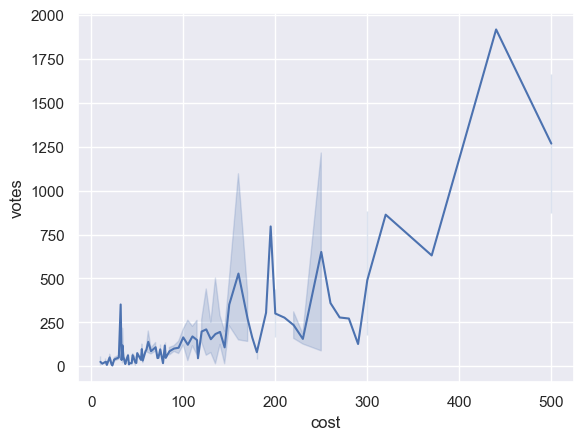

In [98]:
sns.lineplot(df, x='cost', y='votes')

* For high price restaurants number of people rated is also higher.

# 5. Multivariate Analysis <a class='anchor' id='multivariate'></a> [↑](#top)

<Axes: xlabel='rating_number', ylabel='votes'>

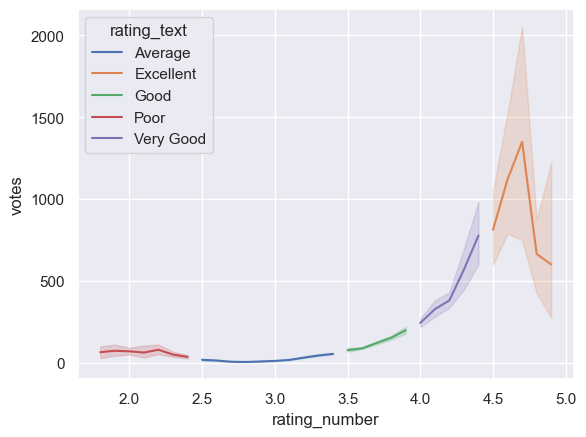

In [99]:
sns.lineplot(df, x='rating_number', y='votes', hue='rating_text')

* As the rating increases number of votes is also increasing.

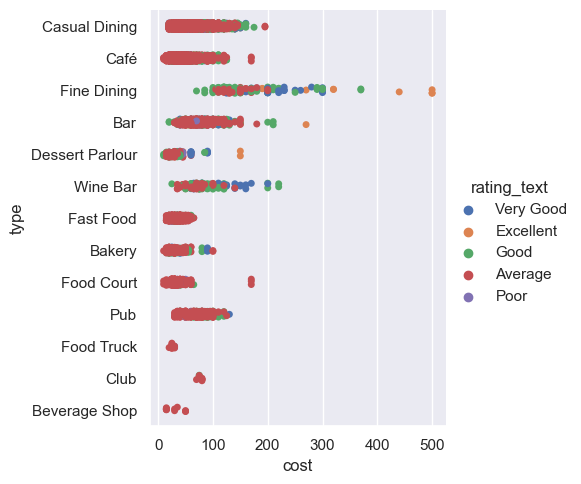

In [100]:
sns.catplot(df_exploded.dropna(), x='cost', y='type', hue='rating_text')

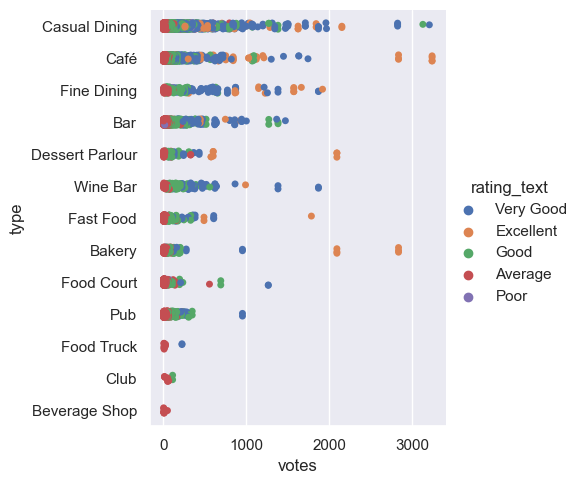

In [101]:
sns.catplot(df_exploded.dropna(), x='votes', y='type', hue='rating_text')

# 6. Cuisine Density Map <a class='anchor' id='cuisinedensity'></a> [↑](#top)

In [102]:
import geopandas

gdf_json = geopandas.read_file("data//sydney.geojson")


In [103]:
gdf = df_exploded[['cuisine', 'lat', 'lng', 'subzone']]
gdf = gdf.drop_duplicates().dropna()

In [104]:
gdf = geopandas.GeoDataFrame(
    gdf, geometry=geopandas.points_from_xy(gdf.lng, gdf.lat), crs="EPSG:4326"
)

In [105]:
gdf = gdf.sjoin(gdf_json, how="right")

In [106]:
gdf.head()

,index_left,cuisine,lat,lng,subzone,SSC_CODE,SSC_NAME,CONF_VALUE,SQKM,geometry
0,2697.0,Italian,-33.881260,150.859422,Bonnyrigg,10001,Abbotsbury,Very good,4.984673,"POLYGON ((150.85118 -33.87069, 150.85104 -33.8..."
0,2697.0,Pizza,-33.881260,150.859422,Bonnyrigg,10001,Abbotsbury,Very good,4.984673,"POLYGON ((150.85118 -33.87069, 150.85104 -33.8..."
0,2697.0,Tapas,-33.881260,150.859422,Bonnyrigg,10001,Abbotsbury,Very good,4.984673,"POLYGON ((150.85118 -33.87069, 150.85104 -33.8..."
0,6411.0,Italian,-33.869781,150.865070,Bonnyrigg,10001,Abbotsbury,Very good,4.984673,"POLYGON ((150.85118 -33.87069, 150.85104 -33.8..."
0,6411.0,Pizza,-33.869781,150.865070,Bonnyrigg,10001,Abbotsbury,Very good,4.984673,"POLYGON ((150.85118 -33.87069, 150.85104 -33.8..."


In [107]:
def show_cuisine_densitymap(df, cuisine='Indian'):
    df = (
        df
        .merge(df
               .groupby(['subzone', 'cuisine'])
               .count()
               .geometry
               .reset_index()
               .rename(columns={'geometry':'restaurants_no'}))
    )
    
    df.restaurants_no = np.where(df.cuisine == 'Indian', df.restaurants_no, np.nan)
    df.plot('restaurants_no', edgecolor="black", cmap='OrRd', categorical=True, )

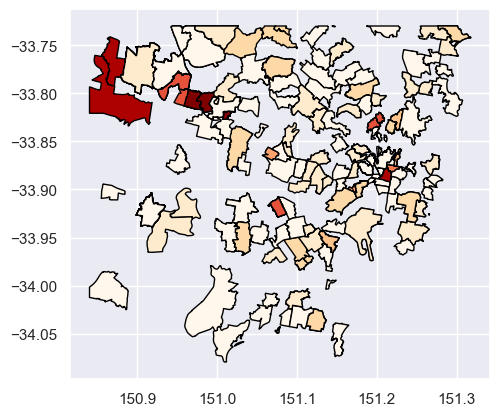

In [108]:
show_cuisine_densitymap(gdf)

In [109]:
# import plotly.express as px

# tempdf = gdf.copy()
# tempdf = (
#         tempdf
#         .merge(tempdf
#                .groupby(['subzone', 'cuisine'])
#                .count()
#                .lat
#                .reset_index()
#                .rename(columns={'lat':'restaurants_no'}))
#     )
# gdf = tempdf.set_index('cuisine')
# fig = px.choropleth_mapbox(gdf,
#                            geojson=gdf.geometry,
#                            locations=gdf.subzone,
#                            color="restaurants_no",
#                            center={"lat":-33.9, "lon": 151.1},
#                            mapbox_style="open-street-map",
#                            zoom=8.5)
# fig.show()

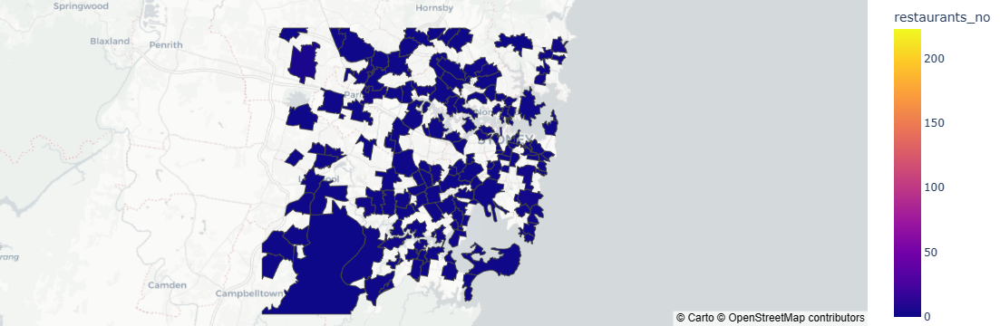

In [110]:
import plotly.express as px

tempdf = (
        df_exploded
        .merge(df_exploded
               .groupby(['subzone', 'cuisine'])
               .count()
               .lat
               .reset_index()
               .rename(columns={'lat':'restaurants_no'}))
    )
fig = px.choropleth_mapbox(tempdf, geojson=gdf_json, color="restaurants_no",
                           locations="subzone", featureidkey="properties.SSC_NAME",
                           center={"lat":-33.9, "lon": 151.1},
                           mapbox_style="carto-positron", zoom=9)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

# 7. Feature Engineering <a class='anchor' id='featureeng'></a> [↑](#top)

In [111]:
df_exploded.columns

Index(['address', 'cost', 'cuisine', 'lat', 'link', 'lng', 'phone',
       'rating_number', 'rating_text', 'subzone', 'title', 'type', 'votes',
       'groupon', 'color', 'cost_2', 'cuisine_color'],
      dtype='object')

In [112]:
feature_list = ['cost', 'cuisine', 'subzone', 'type', 'votes', 'lat', 'lng', 'rating_number']
df_ = df_exploded[feature_list].copy()

In [113]:
df_.info()

<class 'pandas.core.frame.DataFrame'>
Index: 18643 entries, 0 to 10499
Data columns (total 8 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   cost           18059 non-null  float64
 1   cuisine        18643 non-null  object 
 2   subzone        18643 non-null  object 
 3   type           18560 non-null  object 
 4   votes          13239 non-null  float64
 5   lat            18303 non-null  float64
 6   lng            18303 non-null  float64
 7   rating_number  13239 non-null  float64
dtypes: float64(5), object(3)
memory usage: 1.3+ MB


* We need to handle missing values for categorical and numerical columns

In [114]:
## Removing rows where rating_number is Null
df_ = df_[df_.rating_number.notnull()]
df_.shape

(13239, 8)

#### Imputing missing values for columns using mean for numerical and most Frequent for categorical

In [115]:
from sklearn.impute import SimpleImputer

num_cols = df_.select_dtypes(exclude='object').columns
cat_cols = df_.select_dtypes(include='object').columns

num_imputer = SimpleImputer(strategy='mean')
cat_imputer = SimpleImputer(strategy='most_frequent')

num_imputer = num_imputer.fit(df_[num_cols])
df_[num_cols] = num_imputer.transform(df_[num_cols])

cat_imputer = cat_imputer.fit(df_[cat_cols])
df_[cat_cols] = cat_imputer.transform(df_[cat_cols])

In [116]:
df_.isnull().sum()

cost             0
cuisine          0
subzone          0
type             0
votes            0
lat              0
lng              0
rating_number    0
dtype: int64

In [117]:
df_ = df_.sample(frac=1)

In [118]:
from sklearn.model_selection import train_test_split

## Splitting data into train, 
X, X_test, y, y_test = train_test_split(df_.drop('rating_number', axis=1), df_.rating_number, test_size=0.2, random_state=0)

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=0)

In [119]:
from category_encoders.ordinal import OrdinalEncoder
from category_encoders.target_encoder import TargetEncoder
from category_encoders.m_estimate import MEstimateEncoder
from category_encoders.leave_one_out import LeaveOneOutEncoder
from category_encoders.cat_boost import CatBoostEncoder
from category_encoders.james_stein import JamesSteinEncoder
from category_encoders.one_hot import OneHotEncoder

#### Finding what type of encoding should be better for our data by fitting a LinearRegression model on encoded data and checking R2 score

In [120]:
import gc
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.linear_model import LinearRegression

encoder_list = [ OrdinalEncoder(), TargetEncoder(), MEstimateEncoder(), 
                JamesSteinEncoder(), LeaveOneOutEncoder() ,CatBoostEncoder(), OneHotEncoder()]


for encoder in encoder_list:
    print("Test {} : ".format(str(encoder).split('(')[0]), end=" ")
    
    train_enc = encoder.fit_transform(X_train.select_dtypes(include='object'), y_train)
    val_enc = encoder.transform(X_val.select_dtypes(include='object'))
    # test_enc = encoder.transform(X_test.select_dtypes(include='object'))

    train_enc = pd.concat([train_enc, X_train.select_dtypes(exclude='object')], axis=1)
    val_enc = pd.concat([val_enc, X_val.select_dtypes(exclude='object')], axis=1)
    # test_enc = pd.concat([test_enc, X_test.select_dtypes(exclude='object')], axis=1)
    
    lr = LinearRegression()
    lr.fit(train_enc, y_train)

    lr_pred = lr.predict(val_enc)
    # lr_pred_test = lr.predict(test_enc)

    score = mean_squared_error(y_val, lr_pred)
    print("MSE: ", score)
    # print("RMSE: ", r2_score(y_val, lr_pred))
    del train_enc
    del val_enc
    gc.collect()

Test OrdinalEncoder :  MSE:  0.15261833132172092
Test TargetEncoder :  MSE:  0.14130607079376242
Test MEstimateEncoder :  MSE:  0.13837721736131434
Test JamesSteinEncoder :  MSE:  0.13888972144909825
Test LeaveOneOutEncoder :  MSE:  0.1372230791183106
Test CatBoostEncoder :  MSE:  0.13741522225906816
Test OneHotEncoder :  MSE:  788896242525777.1


* Best encoding for our data is Ordinal encoding.

#### Creating Pipeline for encoding and preprocessing data

In [121]:
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler

NUM_FEATURES = X_train.select_dtypes(exclude='object').columns
CAT_FEATURES = X_train.select_dtypes(include='object').columns

num_pipe = Pipeline(steps=[
    ('scale', StandardScaler()),   
])
cat_pipe = Pipeline(steps=[    
    ('encode', OrdinalEncoder()),   
    ('scale', StandardScaler(with_mean=False)),
])

preprocessor = ColumnTransformer(transformers=[
    ('num', num_pipe, NUM_FEATURES),
    ('cat', cat_pipe, CAT_FEATURES),
], remainder='drop')

### Feature or subset selection
We will use cross validation to find R2 and Adjusted R2 scores and we will use sklearn's SelectKBest to find the optimum number of features.

In [122]:
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import cross_val_score


r2scores=[]
adjustedr2 = []
feature_names=[]
for i in range(1, 8):   
    reduce_dim_pipe = Pipeline(steps=[
        ('preprocess', preprocessor),
        ('reduce_dim', SelectKBest(k=i, score_func=f_regression)),       
    ])
    
    pipeline = Pipeline(steps=[
        ('reduce_dim_pipe', reduce_dim_pipe),       
        ('regress', LinearRegression())
    ])
    
    # calculate cross validated R2
    R2 = cross_val_score(pipeline, X=X_train, y=y_train,cv=10, scoring='r2').mean()    
    r2scores.append(R2)
        
    # calculate Adj R2
    n= len(X_train)
    p = i #len(X.columns)
    adj_R2 = 1- ((1-R2) * (n-1)/(n-p-1)) #Adj R2 = 1-(1-R2)*(n-1)/(n-p-1)
    # print(R2, adj_R2)
    adjustedr2.append(adj_R2)
    
    reduce_dim_pipe.fit(X=X_train, y=y_train)
    # Get columns to keep    
    cols = reduce_dim_pipe.named_steps['reduce_dim'].get_support(indices=True)
    # Create new dataframe with only desired columns
    # print(cols)
    features_df_new = X_train.iloc[:, cols]
    best_features = list(features_df_new.columns)
    # print(best_features)
    feature_names.append(best_features)

In [123]:
scoring_df = pd.DataFrame(np.column_stack((r2scores, adjustedr2)), columns=['R2', 'Adj_R2'])
scoring_df['feature_names'] = feature_names
scoring_df['features'] = range(1, 8)
scoring_df

,R2,Adj_R2,feature_names,features
0,0.274213,0.274127,[cuisine],1
1,0.283626,0.283457,"[cost, cuisine]",2
2,0.294833,0.294583,"[cost, cuisine, lat]",3
3,0.294668,0.294335,"[cost, cuisine, votes, lat]",4
4,0.295896,0.295480,"[cost, cuisine, votes, lat, lng]",5
5,0.295829,0.295330,"[cost, cuisine, subzone, votes, lat, lng]",6
6,0.295391,0.294809,"[cost, cuisine, subzone, type, votes, lat, lng]",7


* Best feature for predicting rating_number is cuisine.
* There is almost no increase in R2 and Adjusted R2 after 3 features.
* R2 and Adjusted R2 are almost equal for all number of features.

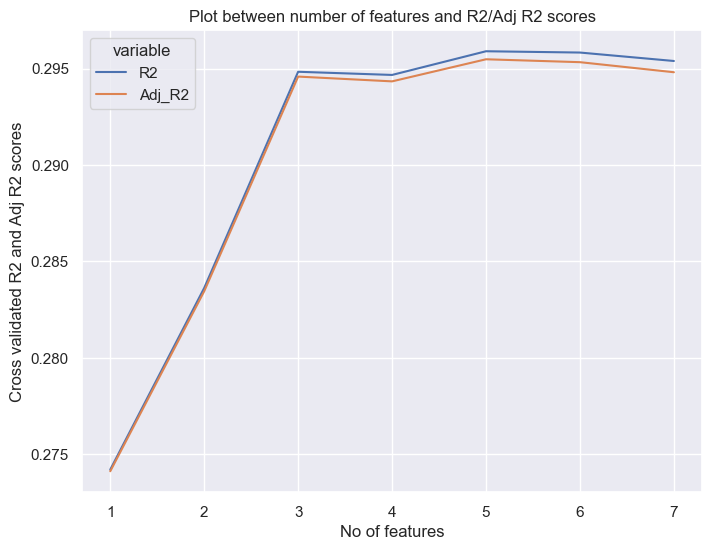

In [124]:
fig, ax = plt.subplots(figsize=(8, 6))
# convert data frame from wide format to long format 
# so that we can pass into seaborn line plot function to draw multiple line plots in same figure
# https://stackoverflow.com/questions/52308749/how-do-i-create-a-multiline-plot-using-seaborn

long_format_df = pd.melt(scoring_df.loc[:, ['features','R2', 'Adj_R2']], ['features'])
sns.lineplot(x='features', y='value', hue='variable', data=long_format_df, ax=ax)
ax.set_xlabel('No of features')
ax.set_ylabel('Cross validated R2 and Adj R2 scores')
ax.set_title('Plot between number of features and R2/Adj R2 scores')
plt.show()

* The most important feature is 'cuisine'
* We can see that after 3 features, there is not much increament in R2 scores.
* We should not add more features to our model and that can add additional noise and can cause overfitting.

# 8. Linear Regression <a class='anchor' id='linearreg'></a> [↑](#top)

#### Linear Regression with Oridinary Least Square method

In [125]:
# Statmodels implementation of Linear regression 
import statsmodels.api as sm
# Lets scale the data, standardization 
from sklearn.preprocessing import StandardScaler, MinMaxScaler

train_X = X[['cuisine', 'cost', ]]
test_X = X_test[['cuisine', 'cost']]

encoder = OrdinalEncoder()

train_enc = encoder.fit_transform(train_X.select_dtypes(include='object'), y)
train_enc = pd.concat([train_enc, train_X.select_dtypes(exclude='object')], axis=1)

test_enc = encoder.transform(test_X.select_dtypes(include='object'))
test_enc = pd.concat([test_enc, test_X.select_dtypes(exclude='object')], axis=1)

sc = StandardScaler()
cols = train_enc.columns
train_enc[cols] = sc.fit_transform(train_enc[cols])

X_sm = sm.add_constant(train_enc.to_numpy())  #Statmodels default is without intercept, to add intercept we need to add constant 
test_enc = sm.add_constant(test_enc.to_numpy())

sm_model = sm.OLS(y, X_sm).fit()

print(sm_model.summary())

                            OLS Regression Results                            
Dep. Variable:          rating_number   R-squared:                       0.050
Model:                            OLS   Adj. R-squared:                  0.049
Method:                 Least Squares   F-statistic:                     275.9
Date:                Fri, 29 Sep 2023   Prob (F-statistic):          1.53e-117
Time:                        00:52:18   Log-Likelihood:                -6678.0
No. Observations:               10591   AIC:                         1.336e+04
Df Residuals:                   10588   BIC:                         1.338e+04
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          3.3176      0.004    750.977      0.0

In [126]:
y_pred = sm_model.predict(test_enc)

print('MSE for OLS: ', mean_squared_error(y_test, y_pred).round(4))

MSE for OLS:  46.9886


#### Linear Regression with Gradient Descent method

In [127]:
NUM_FEATURES = X.select_dtypes(exclude='object').columns
CAT_FEATURES = X.select_dtypes(include='object').columns

num_pipe = Pipeline(steps=[
    ('scale', StandardScaler()),   
])
cat_pipe = Pipeline(steps=[    
    ('encode', OrdinalEncoder()),   
    ('scale', StandardScaler(with_mean=False)),
])

preprocessor = ColumnTransformer(transformers=[
    ('num', num_pipe, NUM_FEATURES),
    ('cat', cat_pipe, CAT_FEATURES),
], remainder='drop')

lr_pipeline = Pipeline(steps=[
        ('preprocess', preprocessor),       
        ('regress', LinearRegression())
    ])

In [128]:
lr_pipeline.fit(X, y)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('scale',
                                                                   StandardScaler())]),
                                                  Index(['cost', 'votes', 'lat', 'lng'], dtype='object')),
                                                 ('cat',
                                                  Pipeline(steps=[('encode',
                                                                   OrdinalEncoder()),
                                                                  ('scale',
                                                                   StandardScaler(with_mean=False))]),
                                                  Index(['cuisine', 'subzone', 'type'], dtype='object'))])),
                ('regress', LinearRegression())])

In [129]:
y_pred = lr_pipeline.predict(X_test)
print('MSE for Gradient Descent Linear Regression: ', mean_squared_error(y_test, y_pred).round(4))

MSE for Gradient Descent Linear Regression:  0.1393


* Mean Squared Error for OLS:  49.9597
* Mean Squared Error for Gradient Descent Linear Regression:  0.1401

# 9. Logistic Regression <a class='anchor' id='logisticreg'></a> [↑](#top)

In [144]:
df_ = df_exploded[['cost', 'cuisine', 'subzone', 'type', 'votes', 'rating_text']]
df_

,cost,cuisine,subzone,type,votes,rating_text
0,50.0,Hot Pot,CBD,Casual Dining,1311.0,Very Good
0,50.0,Korean BBQ,CBD,Casual Dining,1311.0,Very Good
0,50.0,BBQ,CBD,Casual Dining,1311.0,Very Good
0,50.0,Korean,CBD,Casual Dining,1311.0,Very Good
1,80.0,Cafe,"The Grounds of Alexandria, Alexandria",Café,3236.0,Excellent
...,...,...,...,...,...,...
10495,40.0,Chinese,Parramatta,Casual Dining,NaN,NaN
10496,20.0,Beverages,Lakemba,Bar,NaN,NaN
10497,20.0,Sushi,Penrith,Food Court,NaN,NaN
10498,15.0,Sushi,St Marys,Food Court,NaN,NaN


In [145]:
df_ = df_[df_.rating_text.notnull()]
df_.shape

(13239, 6)

In [146]:
df_.rating_text = (df_
                   .rating_text
                   .apply(lambda x: 'class1' if x in ['Poor', 'Average'] else 'class2' )
)

In [147]:
df_

,cost,cuisine,subzone,type,votes,rating_text
0,50.0,Hot Pot,CBD,Casual Dining,1311.0,class2
0,50.0,Korean BBQ,CBD,Casual Dining,1311.0,class2
0,50.0,BBQ,CBD,Casual Dining,1311.0,class2
0,50.0,Korean,CBD,Casual Dining,1311.0,class2
1,80.0,Cafe,"The Grounds of Alexandria, Alexandria",Café,3236.0,class2
...,...,...,...,...,...,...
9596,65.0,Modern Australian,Bankstown,Casual Dining,4.0,class1
10212,60.0,Pizza,Chatswood Rsl,Casual Dining,4.0,class1
10212,60.0,Bar Food,Chatswood Rsl,Casual Dining,4.0,class1
10212,60.0,Pizza,Chatswood Rsl,Bar,4.0,class1


In [178]:
## Splitting data into train, 
X_train, X_test, y_train, y_test = train_test_split(df_.drop('rating_text', axis=1), df_.rating_text, test_size=0.2, random_state=0)

In [149]:
from sklearn.linear_model import LogisticRegression

In [179]:
NUM_FEATURES = X_train.select_dtypes(exclude='object').columns
CAT_FEATURES = X_train.select_dtypes(include='object').columns

num_pipe = Pipeline(steps=[
    ('num_imputer', SimpleImputer(strategy='mean')),
    ('scale', StandardScaler()),   
])
cat_pipe = Pipeline(steps=[
    ('cat_imputer', SimpleImputer(strategy='most_frequent')) ,  
    ('encode', OrdinalEncoder()),   
    ('scale', StandardScaler(with_mean=False)),
])

preprocessor = ColumnTransformer(transformers=[
    ('num', num_pipe, NUM_FEATURES),
    ('cat', cat_pipe, CAT_FEATURES),
], remainder='drop')



In [191]:
from sklearn.pipeline import make_pipeline
from sklearn.metrics import f1_score
train_scores = []
val_scores = []
la_values = []
X_train_, X_val, y_train_, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=0)

for la in np.arange(0.01, 12000.0, 100): # range of values of Lambda
    lr = make_pipeline( preprocessor, LogisticRegression(C=1/la))
    lr.fit(X_train_, y_train_)
    train_score = f1_score(y_train_, lr.predict(X_train_), pos_label="class1")
    val_score = f1_score(y_val, lr.predict(X_val), pos_label="class1")
    train_scores.append(train_score)
    val_scores.append(val_score)
    la_values.append(la)


In [192]:
print(max(train_scores), max(val_scores))
max_train_index = max(enumerate(train_scores),key=lambda x: x[1])[0]
max_val_index = max(enumerate(val_scores),key=lambda x: x[1])[0]

print(la_values[max_train_index], la_values[max_val_index])

0.8683976524986663 0.869076869076869
0.01 0.01


In [193]:
logistic_pipeline = Pipeline(steps=[
        ('preprocess', preprocessor),       
        ('regress', LogisticRegression(C=1/0.01))
    ])

logistic_pipeline.fit(X_train, y_train)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('num',
                                                  Pipeline(steps=[('num_imputer',
                                                                   SimpleImputer()),
                                                                  ('scale',
                                                                   StandardScaler())]),
                                                  Index(['cost', 'votes'], dtype='object')),
                                                 ('cat',
                                                  Pipeline(steps=[('cat_imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('encode',
                                                                   OrdinalEncoder()),
                                                                  ('scale',
                                                                   StandardScaler(with_mean=False))]),
                                                  Index(['cuisine', 'subzone', 'type'], dtype='object'))])),
                ('regress', LogisticRegression(C=100.0))])

In [194]:
y_pred = logistic_pipeline.predict(X_test)

In [195]:
from sklearn.metrics import confusion_matrix

confusion_matrix(y_test, y_pred, normalize='all')

array([[0.59176737, 0.04493958],
       [0.13595166, 0.22734139]])

In [196]:
print(f'Train Accuracy:{logistic_pipeline.score(X_train,y_train)} \nTest Accuracy:{logistic_pipeline.score(X_test,y_test) }' ) 

Train Accuracy:0.8245680294589746 
Test Accuracy:0.8191087613293051


In [197]:
from sklearn.preprocessing import FunctionTransformer
from sklearn.pipeline import Pipeline

names = X_train.columns.tolist()

pipe_preprocessor = Pipeline([("preprocessor", preprocessor), 
                              ("pandarizer", FunctionTransformer(lambda x: pd.DataFrame(x, columns = names)))]).fit(X_train)
    
X_train_pipe = pipe_preprocessor.transform(X_train)
X_test_pipe = pipe_preprocessor.transform(X_test)

In [198]:
X_train_pipe

,cost,cuisine,subzone,type,votes
0,0.583097,-0.145289,0.049604,0.009198,0.593298
1,-0.750937,-0.336151,0.099207,0.018395,1.186596
2,-0.250674,-0.069948,0.148811,0.027593,1.779894
3,-0.584182,-0.160357,0.198414,0.036790,1.779894
4,2.750900,0.382094,0.248018,0.045988,1.779894
...,...,...,...,...,...
10586,1.416867,-0.461719,0.049604,4.672379,1.779894
10587,0.583097,-0.069948,0.396828,0.045988,2.966490
10588,-0.917691,-0.240720,0.148811,1.646370,1.779894
10589,-0.584182,-0.441628,0.396828,2.281004,2.966490


In [170]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier

from sklearn.metrics import classification_report
from sklearn.pipeline import make_pipeline


In [171]:
names = [
    "Nearest Neighbors",
    "Linear SVM",
    "RBF SVM",
    "Decision Tree",
    "Random Forest",
    
]

In [172]:
classifiers = [
    KNeighborsClassifier(3),
    SVC(kernel="linear", C=0.025, random_state=0),
    SVC(gamma=2, C=1, random_state=0),
    DecisionTreeClassifier(max_depth=5, random_state=0),
    RandomForestClassifier(
        max_depth=10, n_estimators=10, max_features=2, random_state=0
    ),
]


In [174]:
# iterate over classifiers
for name, clf in zip(names, classifiers):

    clf = make_pipeline(StandardScaler(), clf)
    clf.fit(X_train_pipe, y_train)
    score = clf.score(X_test_pipe, y_test)
    
    y_pred = clf.predict(X_test_pipe)
    print(f'{name:.^50}')
    print('Confusion Matrix : ')
    display(confusion_matrix(y_test, y_pred))
    # print('Acurracy Score : 'score)
    print()
    print(classification_report(y_test, y_pred))
    
    print('*'*50)
    print()

................Nearest Neighbors.................
Confusion Matrix : 


array([[1476,  210],
       [ 310,  652]], dtype=int64)


              precision    recall  f1-score   support

      class1       0.83      0.88      0.85      1686
      class2       0.76      0.68      0.71       962

    accuracy                           0.80      2648
   macro avg       0.79      0.78      0.78      2648
weighted avg       0.80      0.80      0.80      2648

**************************************************

....................Linear SVM....................
Confusion Matrix : 


array([[1574,  112],
       [ 371,  591]], dtype=int64)


              precision    recall  f1-score   support

      class1       0.81      0.93      0.87      1686
      class2       0.84      0.61      0.71       962

    accuracy                           0.82      2648
   macro avg       0.82      0.77      0.79      2648
weighted avg       0.82      0.82      0.81      2648

**************************************************

.....................RBF SVM......................
Confusion Matrix : 


array([[1513,  173],
       [ 251,  711]], dtype=int64)


              precision    recall  f1-score   support

      class1       0.86      0.90      0.88      1686
      class2       0.80      0.74      0.77       962

    accuracy                           0.84      2648
   macro avg       0.83      0.82      0.82      2648
weighted avg       0.84      0.84      0.84      2648

**************************************************

..................Decision Tree...................
Confusion Matrix : 


array([[1469,  217],
       [ 189,  773]], dtype=int64)


              precision    recall  f1-score   support

      class1       0.89      0.87      0.88      1686
      class2       0.78      0.80      0.79       962

    accuracy                           0.85      2648
   macro avg       0.83      0.84      0.84      2648
weighted avg       0.85      0.85      0.85      2648

**************************************************

..................Random Forest...................
Confusion Matrix : 


array([[1503,  183],
       [ 164,  798]], dtype=int64)


              precision    recall  f1-score   support

      class1       0.90      0.89      0.90      1686
      class2       0.81      0.83      0.82       962

    accuracy                           0.87      2648
   macro avg       0.86      0.86      0.86      2648
weighted avg       0.87      0.87      0.87      2648

**************************************************

